In [1]:
import os
import torch
import warnings
warnings.simplefilter('ignore')
import numpy as np
import torchvision
import torch.nn as nn
from torchvision import datasets, transforms
from torch.utils.data import DataLoader
import matplotlib.pyplot as plt
import torch.optim as optim
import torch.nn.functional as F
import torchvision.models as models

## Duplicate Images

In [ ]:
# Flatten the image into 256*256 row
# convert all these into a string
# hash on each string
# find duplicate string


## Data Preprocessing

In [66]:
# Current data in the train folder is augmented with each image having 4 copies rotated for different angles. We need 
# move some of these images for validation purpose
import random

def hidden_file_exists(lstItems, filename = '.DS_Store'):
    if filename in lstItems:
        lstItems.remove('.DS_Store')
    return(lstItems)

ROOT_DIR = './dataset/train'
TEST_DIR = './dataset/test'
dirs = hidden_file_exists(lstItems=os.listdir(ROOT_DIR))

print(f'Total number of labels in the data - {len(dirs)}')

for folder in dirs:
    if((not os.path.isfile(TEST_DIR + '/' + folder)) or (not os.path.exists(TEST_DIR + '/' + folder))):
        print(f'Processing data for crop type - {folder}')
        all_files = hidden_file_exists(lstItems=os.listdir(ROOT_DIR + '/' + folder))
        items = int(len(all_files)/10)
        test_files = random.sample(all_files, items)
        train_files = list(set(all_files) - set(test_files))

        if not os.path.exists(TEST_DIR + '/' + folder):
            os.makedirs(TEST_DIR + '/' + folder)
    
        for match in test_files: 
            for file in all_files:
                if file[0:8] == match[0:8]:
                    print(f'Moving file {file}')
                    source = os.path.join(ROOT_DIR, folder, file)
                    dest = os.path.join(TEST_DIR, folder, file)
                    try:
                        os.rename(source, dest)
                    except:
                        pass


Total number of labels in the data - 38
Processing data for crop type - Strawberry___healthy
Moving file 8b799a37-bc78-416f-9081-1ac2d8caba6b___RS_HL 2190_90deg.JPG
Moving file 8b799a37-bc78-416f-9081-1ac2d8caba6b___RS_HL 2190_180deg.JPG
Moving file 8b799a37-bc78-416f-9081-1ac2d8caba6b___RS_HL 2190_270deg.JPG
Moving file 8b799a37-bc78-416f-9081-1ac2d8caba6b___RS_HL 2190.JPG
Moving file c3d65977-d35a-4f0f-9e36-bf36f4dbdee8___RS_HL 2214_new30degFlipLR.JPG
Moving file c3d65977-d35a-4f0f-9e36-bf36f4dbdee8___RS_HL 2214_90deg.JPG
Moving file c3d65977-d35a-4f0f-9e36-bf36f4dbdee8___RS_HL 2214_270deg.JPG
Moving file c3d65977-d35a-4f0f-9e36-bf36f4dbdee8___RS_HL 2214.JPG
Moving file ee0f49c6-8884-4e96-8ebc-ceec0b9b69c4___RS_HL 1632_270deg.JPG
Moving file ee0f49c6-8884-4e96-8ebc-ceec0b9b69c4___RS_HL 1632_90deg.JPG
Moving file ee0f49c6-8884-4e96-8ebc-ceec0b9b69c4___RS_HL 1632.JPG
Moving file feea7aff-b70c-46dd-8ff4-be06e7920fa9___RS_HL 1807_90deg.JPG
Moving file feea7aff-b70c-46dd-8ff4-be06e7920fa9

Moving file 2860c88f-4efe-4925-910a-a8b6cea599f7___FAM_B.Rot 3209.JPG
Moving file 2860c88f-4efe-4925-910a-a8b6cea599f7___FAM_B.Rot 3209_flipLR.JPG
Moving file 38c1021c-5941-4106-88f0-973de55bfe59___FAM_B.Rot 3367_flipLR.JPG
Moving file 4231101f-c683-4711-9949-b99e5ff30e64___FAM_B.Rot 3396.JPG
Moving file 4231101f-c683-4711-9949-b99e5ff30e64___FAM_B.Rot 3396_flipLR.JPG
Moving file 25b865db-bc3b-495f-aab9-966787d9f408___FAM_B.Rot 3055.JPG
Moving file 25b865db-bc3b-495f-aab9-966787d9f408___FAM_B.Rot 3055_flipLR.JPG
Moving file 211c977e-d5aa-4a3e-8033-2daf1ba12fb5___FAM_B.Rot 0418_flipLR.JPG
Moving file 211c977e-d5aa-4a3e-8033-2daf1ba12fb5___FAM_B.Rot 0418.JPG
Moving file 926fc452-91e5-4683-89bb-0256103e15e1___FAM_B.Rot 0635.JPG
Moving file 926fc452-91e5-4683-89bb-0256103e15e1___FAM_B.Rot 0635_flipLR.JPG
Moving file 06fde815-e82e-42b1-acb6-c097f126fb9b___FAM_B.Rot 0628.JPG
Moving file 06fde815-e82e-42b1-acb6-c097f126fb9b___FAM_B.Rot 0628_flipLR.JPG
Moving file 8bc229a3-e9bd-4691-a50f-d26cd

Moving file 64ced002-f0b1-42b2-b448-b7b3655e38c1___RS_Early.B 9010_flipTB.JPG
Moving file e786a4fe-5aa1-4da2-a16f-4ee82c56e317___RS_Early.B 7245_180deg.JPG
Moving file e786a4fe-5aa1-4da2-a16f-4ee82c56e317___RS_Early.B 7245.JPG
Moving file e786a4fe-5aa1-4da2-a16f-4ee82c56e317___RS_Early.B 7245_flipTB.JPG
Moving file f8b57e69-5902-4253-8404-11811ecf13e8___RS_Early.B 6995.JPG
Moving file f8b57e69-5902-4253-8404-11811ecf13e8___RS_Early.B 6995_180deg.JPG
Moving file 93701beb-c734-41ea-a5ef-9e5ca4728dfc___RS_Early.B 6885_flipTB.JPG
Moving file 93701beb-c734-41ea-a5ef-9e5ca4728dfc___RS_Early.B 6885.JPG
Moving file 93701beb-c734-41ea-a5ef-9e5ca4728dfc___RS_Early.B 6885_180deg.JPG
Moving file 906bb6f0-e61b-42f2-83a9-22593dadcedc___RS_Early.B 8564_180deg.JPG
Moving file 906bb6f0-e61b-42f2-83a9-22593dadcedc___RS_Early.B 8564_flipTB.JPG
Moving file 97c1fe0d-72f6-421d-bb82-542f0766176c___RS_Early.B 7448_flipTB.JPG
Moving file 97c1fe0d-72f6-421d-bb82-542f0766176c___RS_Early.B 7448.JPG
Moving file 97

Moving file a5506fba-2c74-4387-8511-f5e1ba8c5a94___RS_HL 2668.JPG
Moving file 0d8e77c4-1930-456c-b429-e8774653a8cd___RS_HL 2272_180deg.JPG
Moving file 0d8e77c4-1930-456c-b429-e8774653a8cd___RS_HL 2272_newPixel25.JPG
Moving file 0d8e77c4-1930-456c-b429-e8774653a8cd___RS_HL 2272_new30degFlipLR.JPG
Moving file e8965528-8772-4b1a-8870-1f6d76a2ffeb___RS_HL 2651.JPG
Moving file 4c67dc60-7ffe-4cc2-81fa-f7c6c8291cdf___RS_HL 5126_flipTB.JPG
Moving file 4c67dc60-7ffe-4cc2-81fa-f7c6c8291cdf___RS_HL 5126_newPixel25.JPG
Moving file 4c67dc60-7ffe-4cc2-81fa-f7c6c8291cdf___RS_HL 5126_new30degFlipLR.JPG
Moving file 4c67dc60-7ffe-4cc2-81fa-f7c6c8291cdf___RS_HL 5126_180deg.JPG
Moving file 4688dfad-aca0-4612-9a3b-ecb5bd9a0e8b___RS_HL 2464.JPG
Moving file 69ab2765-4fc0-42ef-967c-9cbe3e5c763e___RS_HL 5350.JPG
Moving file 3c776e9c-bade-4f05-8a7b-6fdff592db76___RS_HL 0373_180deg.JPG
Moving file 3c776e9c-bade-4f05-8a7b-6fdff592db76___RS_HL 0373.JPG
Moving file 3c776e9c-bade-4f05-8a7b-6fdff592db76___RS_HL 0373_

Moving file 2b9b189c-11a8-46ce-9553-acce775bd29d___Com.G_TgS_FL 9978_newPixel25.JPG
Moving file 2b9b189c-11a8-46ce-9553-acce775bd29d___Com.G_TgS_FL 9978_flipTB.JPG
Moving file 1c051bf2-9fb9-4d1f-b5c3-d813c0278aca___Com.G_TgS_FL 9683_newPixel25.JPG
Moving file 1c051bf2-9fb9-4d1f-b5c3-d813c0278aca___Com.G_TgS_FL 9683.JPG
Moving file 1c051bf2-9fb9-4d1f-b5c3-d813c0278aca___Com.G_TgS_FL 9683_180deg.JPG
Moving file 1c051bf2-9fb9-4d1f-b5c3-d813c0278aca___Com.G_TgS_FL 9683_new30degFlipLR.JPG
Moving file 1c051bf2-9fb9-4d1f-b5c3-d813c0278aca___Com.G_TgS_FL 9683_flipTB.JPG
Moving file b9bbf1af-baab-45e5-b804-024a975e4fe0___Com.G_TgS_FL 9807.JPG
Moving file 3da42883-92e8-48db-9203-35799eadd260___Com.G_TgS_FL 9739.JPG
Moving file 3da42883-92e8-48db-9203-35799eadd260___Com.G_TgS_FL 9739_new30degFlipLR.JPG
Moving file 3da42883-92e8-48db-9203-35799eadd260___Com.G_TgS_FL 9739_newPixel25.JPG
Moving file 3da42883-92e8-48db-9203-35799eadd260___Com.G_TgS_FL 9739_180deg.JPG
Moving file c6a1dc1f-e0fd-40df-87

Moving file ec3aa964-fde7-4b00-9231-b9350057aa8a___Rutg._HL 2403_newPixel25.JPG
Moving file ec3aa964-fde7-4b00-9231-b9350057aa8a___Rutg._HL 2403_90deg.JPG
Moving file ec3aa964-fde7-4b00-9231-b9350057aa8a___Rutg._HL 2403_270deg.JPG
Moving file ec3aa964-fde7-4b00-9231-b9350057aa8a___Rutg._HL 2403_new30degFlipLR.JPG
Moving file ec3aa964-fde7-4b00-9231-b9350057aa8a___Rutg._HL 2403.JPG
Moving file 95f38d4e-5e8d-4b72-ac83-bd7e794a3093___Rutg._HL 2498_90deg.JPG
Moving file 95f38d4e-5e8d-4b72-ac83-bd7e794a3093___Rutg._HL 2498_new30degFlipLR.JPG
Moving file 95f38d4e-5e8d-4b72-ac83-bd7e794a3093___Rutg._HL 2498_270deg.JPG
Moving file 95f38d4e-5e8d-4b72-ac83-bd7e794a3093___Rutg._HL 2498.JPG
Moving file c125fe01-53ee-466b-a3c0-ac8cdf10bc8f___Rutg._HL 3565_newPixel25.JPG
Moving file c125fe01-53ee-466b-a3c0-ac8cdf10bc8f___Rutg._HL 3565_90deg.JPG
Moving file c125fe01-53ee-466b-a3c0-ac8cdf10bc8f___Rutg._HL 3565.JPG
Moving file c125fe01-53ee-466b-a3c0-ac8cdf10bc8f___Rutg._HL 3565_new30degFlipLR.JPG
Movi

Moving file dd08ad51-110b-4de0-bfbb-862e53a6165c___RS_LB 4542_flipTB.JPG
Moving file dd08ad51-110b-4de0-bfbb-862e53a6165c___RS_LB 4542_180deg.JPG
Moving file dd08ad51-110b-4de0-bfbb-862e53a6165c___RS_LB 4542.JPG
Moving file c746bac3-3c7a-445c-b78e-19294bd9a9cb___RS_LB 5233.JPG
Moving file c746bac3-3c7a-445c-b78e-19294bd9a9cb___RS_LB 5233_180deg.JPG
Moving file 19393f68-e96c-4c93-b4d1-39e1c54e53b1___RS_LB 4051_flipTB.JPG
Moving file 19393f68-e96c-4c93-b4d1-39e1c54e53b1___RS_LB 4051.JPG
Moving file 19393f68-e96c-4c93-b4d1-39e1c54e53b1___RS_LB 4051_180deg.JPG
Moving file 74277267-6a9f-44d0-95fe-7f52f89630a0___RS_LB 5074_180deg.JPG
Moving file 74277267-6a9f-44d0-95fe-7f52f89630a0___RS_LB 5074.JPG
Moving file a3389c1f-d888-430d-bcf7-a546247ad6d2___RS_LB 3092.JPG
Moving file a3389c1f-d888-430d-bcf7-a546247ad6d2___RS_LB 3092_180deg.JPG
Moving file a3389c1f-d888-430d-bcf7-a546247ad6d2___RS_LB 3092_flipTB.JPG
Moving file 0f6eac3b-d674-4c4d-ab3a-88689feec07f___RS_LB 5232.JPG
Moving file c58de13c

Moving file aee192d9-666e-4ef8-aa5e-86d09d14216c___GHLB2 Leaf 8582.JPG
Moving file 07b42bb5-9f6c-43bc-9bbe-e4b127d84cb6___GHLB Leaf 18.1 Day 8_flipLR.jpg
Moving file 07b42bb5-9f6c-43bc-9bbe-e4b127d84cb6___GHLB Leaf 18.1 Day 8.jpg
Moving file c6f2f79f-4554-4869-84e0-32df4ed15eb4___RS_Late.B 6399.JPG
Moving file 5b4ca8b4-ed80-43c7-90ca-f9912d9fb7b6___RS_Late.B 5226_flipLR.JPG
Moving file 5b4ca8b4-ed80-43c7-90ca-f9912d9fb7b6___RS_Late.B 5226.JPG
Moving file c4f45383-715a-48b2-8ec7-c45d1c230a9d___GHLB_PS Leaf 13.1 Day 7.jpg
Moving file 3b9a0c9e-353a-48c0-9b39-90c4ed35dcb7___RS_Late.B 6289_flipLR.JPG
Moving file 3b9a0c9e-353a-48c0-9b39-90c4ed35dcb7___RS_Late.B 6289.JPG
Moving file f20d4b66-977f-4294-92d2-98322f9a4cb0___RS_Late.B 5137.JPG
Moving file 5df3ce66-bcba-4633-902e-15aaac6a3f94___GHLB2 Leaf 8842.JPG
Moving file 5df3ce66-bcba-4633-902e-15aaac6a3f94___GHLB2 Leaf 8842_flipLR.JPG
Moving file c9258e44-7f45-4baf-8140-69d4857c56ee___GHLB_PS Leaf 45 Day 18.jpg
Moving file 7076ebe9-be52-4b6e

Moving file 389063cb-adf2-412a-b9d3-94ff948d7353___JR_HL 5880.JPG
Moving file 1f66bf0a-3af3-4084-ab73-c1e1b8f3dc46___JR_HL 8824_flipTB.JPG
Moving file 1f66bf0a-3af3-4084-ab73-c1e1b8f3dc46___JR_HL 8824_newPixel25.JPG
Moving file 1f66bf0a-3af3-4084-ab73-c1e1b8f3dc46___JR_HL 8824_new30degFlipLR.JPG
Moving file 1f66bf0a-3af3-4084-ab73-c1e1b8f3dc46___JR_HL 8824_180deg.JPG
Moving file 1ed45244-4767-4607-a59e-61342e8f4750___JR_HL 8601.JPG
Moving file 1ed45244-4767-4607-a59e-61342e8f4750___JR_HL 8601_newPixel25.JPG
Moving file 1ed45244-4767-4607-a59e-61342e8f4750___JR_HL 8601_flipTB.JPG
Moving file 1ed45244-4767-4607-a59e-61342e8f4750___JR_HL 8601_new30degFlipLR.JPG
Moving file 1ed45244-4767-4607-a59e-61342e8f4750___JR_HL 8601_180deg.JPG
Moving file 5af6651e-818b-450b-b45a-008fce7096b3___JR_HL 5888_new30degFlipLR.JPG
Moving file 5af6651e-818b-450b-b45a-008fce7096b3___JR_HL 5888_180deg.JPG
Moving file 5af6651e-818b-450b-b45a-008fce7096b3___JR_HL 5888_newPixel25.JPG
Moving file 5af6651e-818b-450

Moving file f4cb5f19-dc45-463f-b4fa-9fab9284212b___CREC_HLB 7047.JPG
Moving file c2e70cde-6b9c-43f8-a696-aab04117849a___CREC_HLB 4079.JPG
Moving file 3476f9c7-ee54-4962-9e1f-00a8bc250a3e___CREC_HLB 5124.JPG
Moving file a7f79336-d13c-42c7-9b58-134d30de76b6___UF.Citrus_HLB_Lab 1463.JPG
Moving file c230f1d9-95ed-420a-bbf5-c8060cdedc4c___CREC_HLB 7709.JPG
Moving file b33c90f4-4fc5-4ff9-a6bd-439626b5bc71___CREC_HLB 6915.JPG
Moving file 0857104e-fafa-44ab-9ed8-4529a8be31b2___CREC_HLB 7092.JPG
Moving file ce93d4fc-8a73-44bc-bdae-af3e037fc5fc___CREC_HLB 7111.JPG
Moving file a14f75b7-ce51-48e6-a502-0da05a56d2c6___UF.Citrus_HLB_Lab 9664.JPG
Moving file a5807d0d-c26b-43ce-aaf1-1f570ae5ec81___CREC_HLB 4854.JPG
Moving file ecf7fa42-5b02-4c58-b39f-752d30e62e18___CREC_HLB 4163.JPG
Moving file b93a7b96-54fd-49f9-99a1-56f82e4f13d1___UF.Citrus_HLB_Lab 0608.JPG
Moving file af6f937f-0c01-4749-85bb-d0c5cd849c6a___CREC_HLB 7331.JPG
Moving file 69029a12-10c2-4fcb-a926-7ec040956ca9___UF.Citrus_HLB_Lab 1388.JP

Moving file e98c3ab2-eb39-48a5-8beb-d11995a55015___Crnl_L.Mold 9185.JPG
Moving file 9afdf72c-5e19-40bd-8035-daf70f1cf8ce___Crnl_L.Mold 6617.JPG
Moving file 0f740b31-f63b-4193-ab1a-6795c11a7f00___Crnl_L.Mold 7033.JPG
Moving file f7a5605e-ac92-4352-9ae7-1338aa77e8d1___Crnl_L.Mold 6630_180deg.JPG
Moving file f7a5605e-ac92-4352-9ae7-1338aa77e8d1___Crnl_L.Mold 6630.JPG
Moving file f7a5605e-ac92-4352-9ae7-1338aa77e8d1___Crnl_L.Mold 6630_flipTB.JPG
Moving file be834e45-b191-48c6-a47d-832bd36f1774___Crnl_L.Mold 8739_flipTB.JPG
Moving file be834e45-b191-48c6-a47d-832bd36f1774___Crnl_L.Mold 8739_180deg.JPG
Moving file be834e45-b191-48c6-a47d-832bd36f1774___Crnl_L.Mold 8739.JPG
Moving file 9afd64fb-6f24-43d8-8510-8cf2eb0852e3___Crnl_L.Mold 6962.JPG
Moving file 69468833-8b43-4e43-8ebf-b86adcaeee0d___Crnl_L.Mold 6880_flipTB.JPG
Moving file 69468833-8b43-4e43-8ebf-b86adcaeee0d___Crnl_L.Mold 6880.JPG
Moving file 69468833-8b43-4e43-8ebf-b86adcaeee0d___Crnl_L.Mold 6880_180deg.JPG
Moving file 4541dd58-9

Moving file b2afe1e7-b4ba-4e17-8821-8a29d88deb68___FAM_L.Blight 4843.JPG
Moving file b2afe1e7-b4ba-4e17-8821-8a29d88deb68___FAM_L.Blight 4843_flipLR.JPG
Moving file c550df77-b653-4415-be0a-dc04a2ad8abd___FAM_L.Blight 1616.JPG
Moving file c550df77-b653-4415-be0a-dc04a2ad8abd___FAM_L.Blight 1616_flipLR.JPG
Processing data for crop type - Cherry_(including_sour)___Powdery_mildew
Moving file 77e3b2c2-5e50-467f-b081-91a84f9d6436___FREC_Pwd.M 0258_flipLR.JPG
Moving file 77e3b2c2-5e50-467f-b081-91a84f9d6436___FREC_Pwd.M 0258.JPG
Moving file f4021e21-1d79-4eac-a128-3e67ce8d51b4___FREC_Pwd.M 4896.JPG
Moving file f4021e21-1d79-4eac-a128-3e67ce8d51b4___FREC_Pwd.M 4896_flipLR.JPG
Moving file 987c1e12-4c60-42e9-8ba7-4ba0a08c849a___FREC_Pwd.M 4491.JPG
Moving file 987c1e12-4c60-42e9-8ba7-4ba0a08c849a___FREC_Pwd.M 4491_flipLR.JPG
Moving file 118fc556-d623-4ac9-95e3-e42052930df4___FREC_Pwd.M 5040_flipLR.JPG
Moving file d12701d9-e2d8-4647-aad4-e09f34117cc3___FREC_Pwd.M 0364_flipLR.JPG
Moving file d12701

Moving file e15e3b48-edda-485d-b5a0-0d876f441b73___FREC_C.Rust 3692_90deg.JPG
Moving file e15e3b48-edda-485d-b5a0-0d876f441b73___FREC_C.Rust 3692.JPG
Moving file e15e3b48-edda-485d-b5a0-0d876f441b73___FREC_C.Rust 3692_newGRR.JPG
Moving file e15e3b48-edda-485d-b5a0-0d876f441b73___FREC_C.Rust 3692_new30degFlipLR.JPG
Moving file e15e3b48-edda-485d-b5a0-0d876f441b73___FREC_C.Rust 3692_new30degFlipTB.JPG
Moving file fdaecc2c-c48c-447d-9cdc-5d52efdc979a___FREC_C.Rust 3858.JPG
Moving file fdaecc2c-c48c-447d-9cdc-5d52efdc979a___FREC_C.Rust 3858_180deg.JPG
Moving file fdaecc2c-c48c-447d-9cdc-5d52efdc979a___FREC_C.Rust 3858_270deg.JPG
Moving file fdaecc2c-c48c-447d-9cdc-5d52efdc979a___FREC_C.Rust 3858_new30degFlipLR.JPG
Moving file fdaecc2c-c48c-447d-9cdc-5d52efdc979a___FREC_C.Rust 3858_new30degFlipTB.JPG
Moving file fdaecc2c-c48c-447d-9cdc-5d52efdc979a___FREC_C.Rust 3858_90deg.JPG
Moving file dee4cbf1-9bdd-451a-b1bb-21756fd981e9___FREC_C.Rust 3727_new30degFlipLR.JPG
Moving file dee4cbf1-9bdd-45

Moving file fc6a1ebf-65e5-45f1-be33-1f2bd3dc4d71___GCREC_Bact.Sp 3511.JPG
Moving file e39108c9-61e6-405a-bad1-84f0d1fbb25b___GCREC_Bact.Sp 5915.JPG
Moving file 096c159e-7f45-404c-ba64-eecc7941ce23___GCREC_Bact.Sp 5675.JPG
Moving file 5a198510-9f1e-4699-b747-d0b1c0892756___UF.GRC_BS_Lab Leaf 0768.JPG
Moving file 867065cd-2f2f-4937-8cf1-ac6aaa695fb6___GCREC_Bact.Sp 5918.JPG
Moving file f0256cb3-6072-453f-9230-2ab16c2db646___GCREC_Bact.Sp 6303.JPG
Moving file a88da7e7-fe37-42e3-bbe6-784f82ed1099___GCREC_Bact.Sp 5828.JPG
Moving file 2b6acf2e-3476-48a4-baa4-51aa62278537___GCREC_Bact.Sp 2977.JPG
Moving file 8aec5b56-9ab2-4337-9544-c619d25650d7___GCREC_Bact.Sp 3579.JPG
Moving file 311a6db6-e3a0-4e8c-bd17-9cbc62217770___GCREC_Bact.Sp 3107.JPG
Moving file e601dd19-754a-4db4-926b-5e71609f628e___GCREC_Bact.Sp 3342.JPG
Moving file 3d41d2d9-7014-4409-a953-21227ef9d8e1___GCREC_Bact.Sp 3699.JPG
Moving file 2b011bd3-107c-4a83-b961-eb7131d2a76a___UF.GRC_BS_Lab Leaf 0281.JPG
Moving file 65ef97f0-f2d6-48

Moving file 3de46830-0f75-4e2b-bb64-e09b13f4f578___Mt.N.V_HL 6145.JPG
Moving file 3de46830-0f75-4e2b-bb64-e09b13f4f578___Mt.N.V_HL 6145_90deg.JPG
Moving file f72e0604-9654-48b4-b153-2e92383970ce___Mt.N.V_HL 8979.JPG
Moving file f72e0604-9654-48b4-b153-2e92383970ce___Mt.N.V_HL 8979_90deg.JPG
Moving file f72e0604-9654-48b4-b153-2e92383970ce___Mt.N.V_HL 8979_270deg.JPG
Moving file f72e0604-9654-48b4-b153-2e92383970ce___Mt.N.V_HL 8979_new30degFlipLR.JPG
Processing data for crop type - Tomato___Early_blight
Moving file e9e56650-8172-4a98-8100-72e79a3a5858___RS_Erly.B 7481_flipTB.JPG
Moving file e9e56650-8172-4a98-8100-72e79a3a5858___RS_Erly.B 7481_180deg.JPG
Moving file 26e2e7aa-800c-421b-92e8-3e20c5f5757e___RS_Erly.B 7656.JPG
Moving file 801083ae-26f9-4a9a-9e9a-f73fb18b67e5___RS_Erly.B 7363.JPG
Moving file 801083ae-26f9-4a9a-9e9a-f73fb18b67e5___RS_Erly.B 7363_flipTB.JPG
Moving file 4fd3f0e7-cdd9-4151-8734-5f0ad1f52614___RS_Erly.B 9564.JPG
Moving file 9407ce87-44ce-4c7f-89ae-1e497b44ae30___

Moving file bea3af4a-8c33-4695-a59c-5c248f7bb0c2___FAM_B.Msls 4068.JPG
Moving file bea3af4a-8c33-4695-a59c-5c248f7bb0c2___FAM_B.Msls 4068_flipLR.JPG
Moving file c075ebc9-00b0-4d55-bb7c-e990f66c1ca8___FAM_B.Msls 3963.JPG
Moving file c075ebc9-00b0-4d55-bb7c-e990f66c1ca8___FAM_B.Msls 3963_flipLR.JPG
Moving file aa799fdf-9751-4272-afee-3c50acb78054___FAM_B.Msls 4062_flipLR.JPG
Moving file aa799fdf-9751-4272-afee-3c50acb78054___FAM_B.Msls 4062.JPG
Moving file 51de3a69-16ef-4089-b347-7cc75447f050___FAM_B.Msls 1017_flipLR.JPG
Moving file 51de3a69-16ef-4089-b347-7cc75447f050___FAM_B.Msls 1017.JPG
Moving file d7d8a7de-f5f1-48ef-963d-a52234715dc2___FAM_B.Msls 3936_flipLR.JPG
Moving file d7d8a7de-f5f1-48ef-963d-a52234715dc2___FAM_B.Msls 3936.JPG
Moving file 0fc171a5-5a95-47b4-a2b2-6b36b51b27bf___FAM_B.Msls 4381.JPG
Moving file 45d3e97e-8d51-4813-8b10-6eb8ccb58865___FAM_B.Msls 1869_flipLR.JPG
Moving file 45d3e97e-8d51-4813-8b10-6eb8ccb58865___FAM_B.Msls 1869.JPG
Moving file 4d766d16-bad4-48be-87eb

Moving file b93108ac-bbc8-4fcd-9bae-9514ec2f3127___Mary_HL 6326_new30degFlipLR.JPG
Moving file 3706171c-e0c1-45c8-8930-34b094f996cd___Mary_HL 9136.JPG
Moving file 3706171c-e0c1-45c8-8930-34b094f996cd___Mary_HL 9136_90deg.JPG
Moving file 3706171c-e0c1-45c8-8930-34b094f996cd___Mary_HL 9136_new30degFlipLR.JPG
Moving file 3706171c-e0c1-45c8-8930-34b094f996cd___Mary_HL 9136_newPixel25.JPG
Moving file 3706171c-e0c1-45c8-8930-34b094f996cd___Mary_HL 9136_180deg.JPG
Moving file 3706171c-e0c1-45c8-8930-34b094f996cd___Mary_HL 9136_270deg.JPG
Moving file b1e19774-132c-46ac-bff5-afe633f1e989___Mary_HL 9342.JPG
Moving file b1e19774-132c-46ac-bff5-afe633f1e989___Mary_HL 9342_newPixel25.JPG
Moving file b1e19774-132c-46ac-bff5-afe633f1e989___Mary_HL 9342_90deg.JPG
Moving file b1e19774-132c-46ac-bff5-afe633f1e989___Mary_HL 9342_new30degFlipLR.JPG
Moving file b1e19774-132c-46ac-bff5-afe633f1e989___Mary_HL 9342_180deg.JPG
Moving file b1e19774-132c-46ac-bff5-afe633f1e989___Mary_HL 9342_270deg.JPG
Moving fi

Moving file 4929a8cf-a60c-4042-a05e-713f9e95f4b8___Mary_HL 9224_newPixel25.JPG
Moving file ae5a17be-bbf6-47dd-a04d-7fdaa7703a74___Mary_HL 9324_180deg.JPG
Moving file ae5a17be-bbf6-47dd-a04d-7fdaa7703a74___Mary_HL 9324_270deg.JPG
Moving file ae5a17be-bbf6-47dd-a04d-7fdaa7703a74___Mary_HL 9324.JPG
Moving file ae5a17be-bbf6-47dd-a04d-7fdaa7703a74___Mary_HL 9324_90deg.JPG
Moving file ae5a17be-bbf6-47dd-a04d-7fdaa7703a74___Mary_HL 9324_new30degFlipLR.JPG
Moving file 05dfc382-396a-4301-b940-7d1098feba11___Mary_HL 6358_90deg.JPG
Moving file 05dfc382-396a-4301-b940-7d1098feba11___Mary_HL 6358_270deg.JPG
Moving file 05dfc382-396a-4301-b940-7d1098feba11___Mary_HL 6358_newPixel25.JPG
Moving file 05dfc382-396a-4301-b940-7d1098feba11___Mary_HL 6358_180deg.JPG
Moving file 05dfc382-396a-4301-b940-7d1098feba11___Mary_HL 6358_new30degFlipLR.JPG
Moving file d0c5488c-4e1b-4fa3-9bb3-8cec6a772436___Mary_HL 9219_new30degFlipLR.JPG
Moving file d0c5488c-4e1b-4fa3-9bb3-8cec6a772436___Mary_HL 9219.JPG
Moving fi

Moving file 3767f857-a7b6-4801-b56e-b62e642fc508___RS_HL 0425.JPG
Moving file 0cfee8b1-5de4-4118-9e25-f9c37bb6f17e___GH_HL Leaf 252_new30degFlipLR.JPG
Moving file 0cfee8b1-5de4-4118-9e25-f9c37bb6f17e___GH_HL Leaf 252_flipTB.JPG
Moving file 0cfee8b1-5de4-4118-9e25-f9c37bb6f17e___GH_HL Leaf 252.JPG
Moving file 0cfee8b1-5de4-4118-9e25-f9c37bb6f17e___GH_HL Leaf 252_newPixel25.JPG
Moving file e0d4c623-8305-4ded-8164-d8fcd5bc2016___RS_HL 0448.JPG
Moving file 2ea87b73-a52b-4a4c-938f-4ce06335d171___GH_HL Leaf 177.1_180deg.JPG
Moving file 2ea87b73-a52b-4a4c-938f-4ce06335d171___GH_HL Leaf 177.1_new30degFlipLR.JPG
Moving file 2ea87b73-a52b-4a4c-938f-4ce06335d171___GH_HL Leaf 177.1_newPixel25.JPG
Moving file 2ea87b73-a52b-4a4c-938f-4ce06335d171___GH_HL Leaf 177.1_flipTB.JPG
Moving file 2ea87b73-a52b-4a4c-938f-4ce06335d171___GH_HL Leaf 177.1.JPG
Moving file 65b9d788-d9e2-47d7-a5ca-2ca5a9f47cae___RS_HL 9710.JPG
Moving file 4a077dcb-30be-4f8d-9dc9-00f3874b1676___GH_HL Leaf 465_180deg.JPG
Moving file 

Moving file 8703335b-e747-4283-b57e-8467f17fa744___JR_HL 9585_180deg.JPG
Moving file 8703335b-e747-4283-b57e-8467f17fa744___JR_HL 9585_flipTB.JPG
Moving file a36fb3a6-f05b-4541-8617-6079781ea8ed___JR_HL 9831_180deg.JPG
Moving file a36fb3a6-f05b-4541-8617-6079781ea8ed___JR_HL 9831.JPG
Moving file a36fb3a6-f05b-4541-8617-6079781ea8ed___JR_HL 9831_flipTB.JPG
Moving file 70cd29ea-fe96-4f8e-961b-3aa02db4a014___JR_HL 4278_180deg.JPG
Moving file 70cd29ea-fe96-4f8e-961b-3aa02db4a014___JR_HL 4278_flipTB.JPG
Moving file 70cd29ea-fe96-4f8e-961b-3aa02db4a014___JR_HL 4278.JPG
Moving file af85c82e-b339-437d-a443-f13ee6194cb5___JR_HL 4321.JPG
Moving file af85c82e-b339-437d-a443-f13ee6194cb5___JR_HL 4321_180deg.JPG
Moving file af85c82e-b339-437d-a443-f13ee6194cb5___JR_HL 4321_flipTB.JPG
Moving file 6a08468a-7a0a-4bfb-8817-12c98be1f4ec___JR_HL 4036.JPG
Moving file 76e3298c-998d-4bce-956a-f8812315e1d6___JR_HL 3979.JPG
Moving file 76e3298c-998d-4bce-956a-f8812315e1d6___JR_HL 3979_flipTB.JPG
Moving file 7

Moving file e15ccb21-bc3d-4d37-835c-3814e3bf0e86___UF.GRC_YLCV_Lab 09574.JPG
Moving file 1802387a-2c1e-4700-aa3f-2535c62278f0___UF.GRC_YLCV_Lab 02097.JPG
Moving file 98653a34-e204-44fe-93dd-513ab0766bfe___YLCV_GCREC 5140.JPG
Moving file a3b0fe3a-8a97-479f-908e-dc0c08d0771b___UF.GRC_YLCV_Lab 01419.JPG
Moving file db05b5f8-283c-4a32-b5d9-bca967c5c040___YLCV_GCREC 2592.JPG
Moving file ee461982-22bb-4805-9e83-27aae0eebe41___YLCV_NREC 2768.JPG
Moving file ecb4ec4b-1992-43c5-9b1c-2a0e268dec76___YLCV_NREC 0238.JPG
Moving file a3a3d1d4-f9df-459e-8eb5-c4ce73d54cae___UF.GRC_YLCV_Lab 01725.JPG
Moving file e03a6b15-f236-4b0a-a1bc-a61f02f959ed___UF.GRC_YLCV_Lab 01915.JPG
Moving file f3449968-7d8a-4f77-b2c6-5d5d088d8b26___YLCV_NREC 2037.JPG
Moving file aa552f83-86ce-413b-959d-b3c449138726___YLCV_GCREC 5117.JPG
Moving file be6f6c78-2967-453f-baec-9aadf7554141___YLCV_GCREC 2559.JPG
Moving file fdc7082c-3132-409b-8b70-f10b478b3c75___UF.GRC_YLCV_Lab 02164.JPG
Moving file d4f7158a-92eb-48f6-a5c1-b9217f00

Moving file e262e0f7-58e6-4f25-8853-10a6f1566815___YLCV_GCREC 1909.JPG
Moving file af6e9e2e-741a-44de-97d4-54c5226bc96a___UF.GRC_YLCV_Lab 01374.JPG
Moving file 69369114-ce25-4be1-b645-e34a0d7bb649___YLCV_GCREC 5495.JPG
Moving file e3ddfecf-3f09-489d-bf20-7e45e65b991d___UF.GRC_YLCV_Lab 01439.JPG
Moving file f6ecf360-6917-4478-895a-84eb384033cb___YLCV_GCREC 5427.JPG
Moving file c89cadb1-54cc-4020-acf3-9ccc7cabe2d3___UF.GRC_YLCV_Lab 09504.JPG
Moving file f9b694d5-a9f5-44c8-b16d-0e2fc5cc50c5___YLCV_NREC 2446.JPG
Moving file db88046b-79ab-4524-b8ea-b03a7505712d___YLCV_NREC 2745.JPG
Moving file b436da97-ae9f-4078-90d3-4abac91a611c___YLCV_NREC 2770.JPG
Moving file ecd6faa9-df99-4444-9fa9-11acccb0d06f___YLCV_NREC 2508.JPG
Moving file dac7b3e6-1a9d-47c2-af41-0f0a88704989___UF.GRC_YLCV_Lab 03070.JPG
Moving file 286116e9-d8d7-4b2d-b0c8-1323638d25be___UF.GRC_YLCV_Lab 08588.JPG
Moving file b6bd0474-9f04-4dc0-a412-de38a9ae5154___UF.GRC_YLCV_Lab 02397.JPG
Moving file 11796227-f10e-4502-a849-ddff117a0

Moving file dbf6dab4-0765-454c-8cb9-6b4329bca971___FREC_Scab 3225_90deg.JPG
Moving file dbf6dab4-0765-454c-8cb9-6b4329bca971___FREC_Scab 3225_270deg.JPG
Moving file dbf6dab4-0765-454c-8cb9-6b4329bca971___FREC_Scab 3225.JPG
Moving file dbf6dab4-0765-454c-8cb9-6b4329bca971___FREC_Scab 3225_new30degFlipLR.JPG
Moving file 40d60cf0-1311-40c7-9e7e-579e74c92027___FREC_Scab 3136_270deg.JPG
Moving file 40d60cf0-1311-40c7-9e7e-579e74c92027___FREC_Scab 3136.JPG
Moving file 40d60cf0-1311-40c7-9e7e-579e74c92027___FREC_Scab 3136_90deg.JPG
Moving file 2ae81857-0615-4a6a-8d13-1ace0c62284d___FREC_Scab 2992.JPG
Moving file 2ae81857-0615-4a6a-8d13-1ace0c62284d___FREC_Scab 2992_270deg.JPG
Moving file 2ae81857-0615-4a6a-8d13-1ace0c62284d___FREC_Scab 2992_new30degFlipLR.JPG
Moving file 2ae81857-0615-4a6a-8d13-1ace0c62284d___FREC_Scab 2992_90deg.JPG
Moving file 258ce9eb-2b67-475b-b09c-0bc83b0987f1___FREC_Scab 3033_new30degFlipLR.JPG
Moving file 258ce9eb-2b67-475b-b09c-0bc83b0987f1___FREC_Scab 3033.JPG
Moving

Moving file 34c2823b-d1c5-4bd8-a5a7-74bdef959e10___FREC_Scab 3484_90deg.JPG
Moving file 34c2823b-d1c5-4bd8-a5a7-74bdef959e10___FREC_Scab 3484_new30degFlipLR.JPG
Moving file e8fc927f-fac2-4386-be3c-0a8ad0ddd83d___FREC_Scab 3292_270deg.JPG
Moving file e8fc927f-fac2-4386-be3c-0a8ad0ddd83d___FREC_Scab 3292_90deg.JPG
Moving file e8fc927f-fac2-4386-be3c-0a8ad0ddd83d___FREC_Scab 3292_new30degFlipLR.JPG
Moving file 12bc3d5c-2409-426e-b6cb-a08cbf488153___FREC_Scab 3154.JPG
Moving file 12bc3d5c-2409-426e-b6cb-a08cbf488153___FREC_Scab 3154_new30degFlipLR.JPG
Moving file 12bc3d5c-2409-426e-b6cb-a08cbf488153___FREC_Scab 3154_90deg.JPG
Moving file 12bc3d5c-2409-426e-b6cb-a08cbf488153___FREC_Scab 3154_270deg.JPG
Processing data for crop type - Corn_(maize)___Northern_Leaf_Blight
Moving file b8b9d76a-31a4-4e15-b96c-3a22a9f8c40a___RS_NLB 4231_180deg.JPG
Moving file b8b9d76a-31a4-4e15-b96c-3a22a9f8c40a___RS_NLB 4231.JPG
Moving file b8b9d76a-31a4-4e15-b96c-3a22a9f8c40a___RS_NLB 4231_flipTB.JPG
Moving fil

Moving file 61d2e3ab-91a7-4bbc-93a2-c2376b3c434d___RS_NLB 4264_flipTB.JPG
Moving file 61d2e3ab-91a7-4bbc-93a2-c2376b3c434d___RS_NLB 4264.JPG
Moving file 61d2e3ab-91a7-4bbc-93a2-c2376b3c434d___RS_NLB 4264_180deg.JPG
Moving file b3e0815f-d7dc-4481-850e-53d917c244d7___RS_NLB 3569.JPG
Moving file b3e0815f-d7dc-4481-850e-53d917c244d7___RS_NLB 3569_flipTB.JPG
Moving file b3e0815f-d7dc-4481-850e-53d917c244d7___RS_NLB 3569_180deg.JPG
Moving file 67a78d0c-6fc8-423f-a50d-ca3f3ca386bd___RS_NLB 4238_flipTB.JPG
Moving file 67a78d0c-6fc8-423f-a50d-ca3f3ca386bd___RS_NLB 4238_180deg.JPG
Moving file 67a78d0c-6fc8-423f-a50d-ca3f3ca386bd___RS_NLB 4238.JPG
Moving file d9b926c7-d24d-4773-b1c6-c6b911984121___RS_NLB 3600_180deg.JPG
Moving file d9b926c7-d24d-4773-b1c6-c6b911984121___RS_NLB 3600.JPG
Moving file d9b926c7-d24d-4773-b1c6-c6b911984121___RS_NLB 3600_flipTB.JPG
Moving file a8eba89e-be4a-4976-bf12-8386f0caa338___RS_NLB 3740_180deg.JPG
Moving file a8eba89e-be4a-4976-bf12-8386f0caa338___RS_NLB 3740.JPG

Moving file 3d59267d-cf74-4354-a41c-d3f79783fcfd___Com.G_SpM_FL 8667.JPG
Moving file 3d59267d-cf74-4354-a41c-d3f79783fcfd___Com.G_SpM_FL 8667_flipTB.JPG
Moving file 3d59267d-cf74-4354-a41c-d3f79783fcfd___Com.G_SpM_FL 8667_180deg.JPG
Moving file 22372e33-7f94-48f7-b394-421d1489328a___Com.G_SpM_FL 8697.JPG
Moving file 4e6c3abe-6ba6-41d2-b748-a349e40a79aa___Com.G_SpM_FL 8885_180deg.JPG
Moving file 9e1cfd52-d7f1-46a6-a88e-9fafe1f82b69___Com.G_SpM_FL 1283.JPG
Moving file ddc184a0-ee42-44a4-80ee-ece8e67f1cc9___Com.G_SpM_FL 1231.JPG
Moving file b7fb98ad-68d6-46b9-9f17-9d3f111b20fb___Com.G_SpM_FL 1676.JPG
Moving file 04a5f541-9202-4475-b5a0-01c14543f211___Com.G_SpM_FL 8534.JPG
Moving file 04a5f541-9202-4475-b5a0-01c14543f211___Com.G_SpM_FL 8534_180deg.JPG
Moving file 04a5f541-9202-4475-b5a0-01c14543f211___Com.G_SpM_FL 8534_flipTB.JPG
Moving file c9d78d7a-8420-40c0-8282-0967bc79eec5___Com.G_SpM_FL 8627.JPG
Processing data for crop type - Peach___Bacterial_spot
Moving file 23af4fb7-58f4-4321-83e

Moving file 7f4db70a-2dca-4c7d-867b-a3827e89994f___NREC_B.Spot 9172.JPG
Moving file 7c719504-0327-4be0-b898-b50760a26de6___JR_B.Spot 3310.JPG
Moving file 6fc860ea-46cd-4b40-8d53-27c1ebf95935___NREC_B.Spot 1836.JPG
Moving file 65a94537-481e-44d0-a1e1-d8ba6551247d___JR_B.Spot 3202_flipTB.JPG
Moving file 65a94537-481e-44d0-a1e1-d8ba6551247d___JR_B.Spot 3202_180deg.JPG
Moving file 0d2635e7-df23-4ceb-b3ba-3af50bb58357___NREC_B.Spot 1874.JPG
Moving file 4bfd707f-94f4-442d-9dfc-8a96b51653d4___JR_B.Spot 3334.JPG
Moving file dab1cfaf-544d-48e0-bfe7-368d65761902___JR_B.Spot 8904_flipTB.JPG
Moving file dab1cfaf-544d-48e0-bfe7-368d65761902___JR_B.Spot 8904.JPG
Moving file 26ca895f-8155-4d26-a0ac-7e04a7487832___NREC_B.Spot 9222.JPG
Moving file 72fb0734-1e8c-4bdb-a355-959d1ce12cd0___NREC_B.Spot 9066_180deg.JPG
Moving file 72fb0734-1e8c-4bdb-a355-959d1ce12cd0___NREC_B.Spot 9066_flipTB.JPG
Moving file 72fb0734-1e8c-4bdb-a355-959d1ce12cd0___NREC_B.Spot 9066.JPG
Moving file 58fe22f7-f357-448a-b0aa-ebad4

Moving file ae645b07-4c93-45d7-9ee6-83cbf1201e8b___NREC_B.Spot 9119.JPG
Moving file ae645b07-4c93-45d7-9ee6-83cbf1201e8b___NREC_B.Spot 9119_flipTB.JPG
Moving file 5528b2f7-3c8f-4c20-8fdc-5fa996e9a637___JR_B.Spot 3236_180deg.JPG
Moving file 5528b2f7-3c8f-4c20-8fdc-5fa996e9a637___JR_B.Spot 3236.JPG
Moving file c2914371-c45f-4b19-bbf2-22832118ca9b___NREC_B.Spot 9112_180deg.JPG
Moving file c2914371-c45f-4b19-bbf2-22832118ca9b___NREC_B.Spot 9112_flipTB.JPG
Moving file b3f41636-2131-4a92-a65a-50ac160e9456___NREC_B.Spot 9213_180deg.JPG
Moving file b3f41636-2131-4a92-a65a-50ac160e9456___NREC_B.Spot 9213_flipTB.JPG
Moving file 72572ac8-d26b-4684-8e8c-7b396677f2fc___NREC_B.Spot 9191_180deg.JPG
Moving file 72572ac8-d26b-4684-8e8c-7b396677f2fc___NREC_B.Spot 9191_flipTB.JPG
Moving file 72572ac8-d26b-4684-8e8c-7b396677f2fc___NREC_B.Spot 9191.JPG
Moving file d7010297-6cb4-435d-ad31-12758c1520c8___JR_B.Spot 8940_180deg.JPG
Moving file d7010297-6cb4-435d-ad31-12758c1520c8___JR_B.Spot 8940_flipTB.JPG
Mo

Moving file d2b21778-763d-4333-be05-50e71a8738cd___Matt.S_CG 1083.JPG
Moving file 4ae88e50-d807-45d7-b587-5242a2464764___JR_Sept.L.S 2618_flipTB.JPG
Moving file 4ae88e50-d807-45d7-b587-5242a2464764___JR_Sept.L.S 2618.JPG
Moving file 4ae88e50-d807-45d7-b587-5242a2464764___JR_Sept.L.S 2618_180deg.JPG
Moving file 1a555e99-78f6-459f-8572-b877b2e7b73c___Matt.S_CG 7415_180deg.JPG
Moving file 1a555e99-78f6-459f-8572-b877b2e7b73c___Matt.S_CG 7415_flipTB.JPG
Moving file 3dd32fea-62e8-4ae9-b307-5513e845b519___JR_Sept.L.S 2663_flipTB.JPG
Moving file 3dd32fea-62e8-4ae9-b307-5513e845b519___JR_Sept.L.S 2663.JPG
Moving file 4e91dd84-5a88-4b2f-8c08-b48a1c0bfc4c___Matt.S_CG 6575.JPG
Moving file 4e91dd84-5a88-4b2f-8c08-b48a1c0bfc4c___Matt.S_CG 6575_180deg.JPG
Moving file fa61de1d-a49d-4e6b-aa12-61be0e1e7fe7___Matt.S_CG 7576.JPG
Moving file 63ee749d-3285-4bcd-9adc-4771fda912b0___Matt.S_CG 6751.JPG
Moving file 80b30519-3893-4ce1-89f2-49230f25ccad___Matt.S_CG 1529.JPG
Moving file beb68b2e-8410-4421-ac36-2e

Moving file 7be007ef-652d-4cb1-a4b4-efdb50469029___MD_Powd.M 0330_flipLR.JPG
Moving file 1a79bba6-f59b-439f-9b4d-855345db220a___MD_Powd.M 0028_flipLR.JPG
Moving file c2514221-fbf1-4610-9af2-0dc81d306446___UMD_Powd.M 0256.JPG
Moving file df386587-b62f-40c8-b006-90d86552906b___UMD_Powd.M 0213.JPG
Moving file 75006fbc-a1c7-463a-99d2-75673d4f0c1a___MD_Powd.M 0441.JPG
Moving file 31683e73-b8e8-499f-861c-d838136ed228___UMD_Powd.M 0434.JPG
Moving file 6b81f550-eeff-49a7-8bc5-6f87ca477af9___UMD_Powd.M 0098.JPG
Moving file 6b81f550-eeff-49a7-8bc5-6f87ca477af9___UMD_Powd.M 0098_flipLR.JPG
Moving file d1733dc8-7c83-4954-aa05-15d331ffe7c5___MD_Powd.M 9948.JPG
Moving file 4a7a34e4-2cd3-421b-adfc-8a94f701ba8d___UMD_Powd.M 9728.JPG
Moving file 4a7a34e4-2cd3-421b-adfc-8a94f701ba8d___UMD_Powd.M 9728_flipLR.JPG
Moving file 18ff0f9e-9e42-421a-ac09-33b42a708ba3___MD_Powd.M 9985.JPG
Moving file 73dd1bf1-168f-4b18-9b2d-c6ceb30514f9___MD_Powd.M 0509.JPG
Moving file 5391210f-8e62-4633-bdd9-1649862ea454___MD_P

Moving file f19f6395-fe3b-427f-b888-49326cafe697___RS_GLSp 4329_90deg.JPG
Moving file f19f6395-fe3b-427f-b888-49326cafe697___RS_GLSp 4329.JPG
Moving file f19f6395-fe3b-427f-b888-49326cafe697___RS_GLSp 4329_270deg.JPG
Moving file f19f6395-fe3b-427f-b888-49326cafe697___RS_GLSp 4329_new30degFlipLR.JPG
Moving file 2174d811-b088-4b31-8088-1738630b94d4___RS_GLSp 4467_new30degFlipLR.JPG
Moving file 2174d811-b088-4b31-8088-1738630b94d4___RS_GLSp 4467.JPG
Moving file 2174d811-b088-4b31-8088-1738630b94d4___RS_GLSp 4467_90deg.JPG
Moving file 2174d811-b088-4b31-8088-1738630b94d4___RS_GLSp 4467_270deg.JPG
Moving file b131eadc-23e6-4784-92b4-4aaee4293bb7___RS_GLSp 4431_270deg.JPG
Moving file b131eadc-23e6-4784-92b4-4aaee4293bb7___RS_GLSp 4431_new30degFlipLR.JPG
Moving file b131eadc-23e6-4784-92b4-4aaee4293bb7___RS_GLSp 4431_90deg.JPG
Moving file b131eadc-23e6-4784-92b4-4aaee4293bb7___RS_GLSp 4431.JPG
Moving file 3bc17d8a-7efc-469a-a0af-aa8a68e62e89___RS_GLSp 9323_270deg.JPG
Moving file 3bc17d8a-7efc

Moving file b7816ede-6659-4cdf-8b46-d36927981cff___JR_FrgE.S 8677_90deg.JPG
Moving file e8a82871-4dc0-4186-b8f1-0a27f82b60e8___JR_FrgE.S 8626_new30degFlipLR.JPG
Moving file e8a82871-4dc0-4186-b8f1-0a27f82b60e8___JR_FrgE.S 8626_270deg.JPG
Moving file e8a82871-4dc0-4186-b8f1-0a27f82b60e8___JR_FrgE.S 8626_90deg.JPG
Moving file e8a82871-4dc0-4186-b8f1-0a27f82b60e8___JR_FrgE.S 8626.JPG
Moving file f24c943a-6339-48a5-bfb0-b866c926dc16___JR_FrgE.S 2931.JPG
Moving file f24c943a-6339-48a5-bfb0-b866c926dc16___JR_FrgE.S 2931_90deg.JPG
Moving file f24c943a-6339-48a5-bfb0-b866c926dc16___JR_FrgE.S 2931_new30degFlipLR.JPG
Moving file f24c943a-6339-48a5-bfb0-b866c926dc16___JR_FrgE.S 2931_270deg.JPG
Moving file fbbd1259-ea22-4f56-8298-8429d228a07c___JR_FrgE.S 2934_new30degFlipLR.JPG
Moving file fbbd1259-ea22-4f56-8298-8429d228a07c___JR_FrgE.S 2934_270deg.JPG
Moving file fbbd1259-ea22-4f56-8298-8429d228a07c___JR_FrgE.S 2934_90deg.JPG
Moving file a8ce9225-ca25-41ba-8c19-4d80ffcb4c93___JR_FrgE.S 8570_new3

Moving file 57cbfc0a-6720-4672-bda8-e9ad59c0fefc___JR_FrgE.S 8651_new30degFlipLR.JPG
Moving file 57cbfc0a-6720-4672-bda8-e9ad59c0fefc___JR_FrgE.S 8651.JPG
Moving file 57cbfc0a-6720-4672-bda8-e9ad59c0fefc___JR_FrgE.S 8651_90deg.JPG
Moving file 57cbfc0a-6720-4672-bda8-e9ad59c0fefc___JR_FrgE.S 8651_270deg.JPG
Moving file 0f3d45f4-e121-42cd-a5b6-be2f866a0574___JR_FrgE.S 2870_new30degFlipLR.JPG
Moving file 0f3d45f4-e121-42cd-a5b6-be2f866a0574___JR_FrgE.S 2870.JPG
Moving file 0f3d45f4-e121-42cd-a5b6-be2f866a0574___JR_FrgE.S 2870_90deg.JPG
Moving file 0f3d45f4-e121-42cd-a5b6-be2f866a0574___JR_FrgE.S 2870_270deg.JPG
Moving file e4d473a3-83ad-496d-a97f-5aee9d713d69___JR_FrgE.S 2782_new30degFlipLR.JPG
Moving file e4d473a3-83ad-496d-a97f-5aee9d713d69___JR_FrgE.S 2782.JPG
Moving file e4d473a3-83ad-496d-a97f-5aee9d713d69___JR_FrgE.S 2782_270deg.JPG
Processing data for crop type - Apple___healthy
Moving file c9ea6277-0581-43dd-91d6-3fddfdf447be___RS_HL 7412_flipTB.JPG
Moving file c9ea6277-0581-43dd-

Moving file af413561-59ca-4d3a-9e7d-34711b946db4___RS_HL 6298_flipTB.JPG
Moving file af413561-59ca-4d3a-9e7d-34711b946db4___RS_HL 6298.JPG
Moving file 6806c56d-b5d6-45fc-8e96-0d8def5932b9___RS_HL 5692_flipTB.JPG
Moving file 6806c56d-b5d6-45fc-8e96-0d8def5932b9___RS_HL 5692.JPG
Moving file 8c656b1d-5f20-4904-a20b-d0f7ef64e773___RS_HL 7526.JPG
Moving file 1fdc99ae-fbc7-480f-9cde-e80b54744c0d___RS_HL 7972.JPG
Moving file 35f0c52c-8a43-4bf2-8d55-2a827dbc5c4d___RS_HL 7251.JPG
Moving file 62c6270f-9667-492e-be5b-ee599927718a___RS_HL 7671.JPG
Moving file fb0953a0-71a5-4c1c-9fb3-f0d9888c2170___RS_HL 8036_flipTB.JPG
Moving file fb0953a0-71a5-4c1c-9fb3-f0d9888c2170___RS_HL 8036.JPG
Moving file b85dfb75-f620-427c-9108-02547560a2b4___RS_HL 5913_flipTB.JPG
Moving file b85dfb75-f620-427c-9108-02547560a2b4___RS_HL 5913.JPG
Moving file d4ddb36a-e4cf-41be-b3f6-16c584e62b9a___RS_HL 7994_flipTB.JPG
Moving file d4ddb36a-e4cf-41be-b3f6-16c584e62b9a___RS_HL 7994.JPG
Moving file 8704d8b7-1368-441a-bad0-9f05b

Moving file 30937333-8898-4634-8c00-af57d3020ba6___RS_HL 1922.JPG
Moving file 30937333-8898-4634-8c00-af57d3020ba6___RS_HL 1922_new200degFlipTB.JPG
Moving file 30937333-8898-4634-8c00-af57d3020ba6___RS_HL 1922_flipLR.JPG
Moving file 30937333-8898-4634-8c00-af57d3020ba6___RS_HL 1922_new200degFlipLR.JPG
Moving file 30937333-8898-4634-8c00-af57d3020ba6___RS_HL 1922_flipTB.JPG
Moving file 30937333-8898-4634-8c00-af57d3020ba6___RS_HL 1922_newGRR.JPG
Moving file 30937333-8898-4634-8c00-af57d3020ba6___RS_HL 1922_newPixel25.JPG
Moving file 30937333-8898-4634-8c00-af57d3020ba6___RS_HL 1922_270deg.JPG
Moving file 30937333-8898-4634-8c00-af57d3020ba6___RS_HL 1922_180deg.JPG
Moving file 30937333-8898-4634-8c00-af57d3020ba6___RS_HL 1922_new90degFlipTB.JPG
Moving file 30937333-8898-4634-8c00-af57d3020ba6___RS_HL 1922_new30degFlipLR.JPG
Moving file 30937333-8898-4634-8c00-af57d3020ba6___RS_HL 1922_new30degFlipTB.JPG
Moving file ec6e43d3-512d-4908-99f2-c9e2a0be54be___RS_HL 4202_newGGR.JPG
Moving file 

Moving file 923d4cc3-021a-4bcd-9f5f-1d6f69e4ad33___RS_HL 1888_new30degFlipTB.JPG
Moving file fd92bd9c-02cb-4599-8673-9316159504a1___RS_HL 1927_90deg.JPG
Moving file fd92bd9c-02cb-4599-8673-9316159504a1___RS_HL 1927_180deg.JPG
Moving file fd92bd9c-02cb-4599-8673-9316159504a1___RS_HL 1927_270deg.JPG
Moving file fd92bd9c-02cb-4599-8673-9316159504a1___RS_HL 1927_new200degFlipTB.JPG
Moving file fd92bd9c-02cb-4599-8673-9316159504a1___RS_HL 1927_new200degFlipLR.JPG
Moving file fd92bd9c-02cb-4599-8673-9316159504a1___RS_HL 1927_newPixel25.JPG
Moving file fd92bd9c-02cb-4599-8673-9316159504a1___RS_HL 1927_flipLR.JPG
Moving file fd92bd9c-02cb-4599-8673-9316159504a1___RS_HL 1927.JPG
Moving file fd92bd9c-02cb-4599-8673-9316159504a1___RS_HL 1927_new30degFlipTB.JPG
Moving file fd92bd9c-02cb-4599-8673-9316159504a1___RS_HL 1927_new30degFlipLR.JPG
Moving file fd92bd9c-02cb-4599-8673-9316159504a1___RS_HL 1927_new90degFlipLR.JPG
Moving file fd92bd9c-02cb-4599-8673-9316159504a1___RS_HL 1927_new90degFlipTB.J

Moving file 0be9d721-82f5-42c3-b535-7494afe01dbe___RS_HL 1814_newPixel25.JPG
Moving file 0be9d721-82f5-42c3-b535-7494afe01dbe___RS_HL 1814_new200degFlipLR.JPG
Moving file 0be9d721-82f5-42c3-b535-7494afe01dbe___RS_HL 1814_new200degFlipTB.JPG
Moving file 0be9d721-82f5-42c3-b535-7494afe01dbe___RS_HL 1814_flipLR.JPG
Moving file 0be9d721-82f5-42c3-b535-7494afe01dbe___RS_HL 1814_new90degFlipTB.JPG
Moving file 0be9d721-82f5-42c3-b535-7494afe01dbe___RS_HL 1814_new90degFlipLR.JPG
Moving file 0be9d721-82f5-42c3-b535-7494afe01dbe___RS_HL 1814_new30degFlipLR.JPG
Moving file 0be9d721-82f5-42c3-b535-7494afe01dbe___RS_HL 1814_newGGR.JPG
Moving file 0be9d721-82f5-42c3-b535-7494afe01dbe___RS_HL 1814_newGRR.JPG
Moving file 0be9d721-82f5-42c3-b535-7494afe01dbe___RS_HL 1814_new30degFlipTB.JPG
Moving file 413bc2e9-eb2a-48fd-ba65-48b5121fd85c___RS_HL 4200.JPG
Moving file 413bc2e9-eb2a-48fd-ba65-48b5121fd85c___RS_HL 4200_newGGR.JPG
Moving file 413bc2e9-eb2a-48fd-ba65-48b5121fd85c___RS_HL 4200_newGRR.JPG
Movi

Moving file bee17ace-696f-42e9-9f59-b16b13d2e537___RS_HL 3096.JPG
Moving file 70633174-1c06-49e9-b7b8-957043b2f261___RS_HL 6978.JPG
Moving file fbcba277-7f2e-4553-b98f-a0ffb00c5a29___RS_HL 3362.JPG
Moving file edbab8fb-3ef3-4321-80cb-e19c818bdcc7___RS_HL 4410.JPG
Moving file 90064385-ff44-44dc-a698-b3dbc94b2b69___RS_HL 3025.JPG
Moving file bfd10b77-823a-42c5-a153-1c606f9ccf08___RS_HL 6940.JPG
Moving file e2e9bc58-3fb5-4933-8964-12ec7a8c8168___RS_HL 4077.JPG
Moving file d905b009-0f0b-419b-b457-aa3c33e4136d___RS_HL 3215.JPG
Moving file ae093106-e1d6-4383-b599-1d3a3ce9ca7c___RS_HL 4569.JPG
Moving file f85bc238-0ca7-40de-a301-ce92c93c247b___RS_HL 3823.JPG
Moving file fb6d6851-cf45-4dc4-ac53-b267a80ebf3c___RS_HL 3543.JPG
Moving file d902c47b-3ebf-41d9-b375-4902e4819853___RS_HL 3690.JPG
Moving file b01873c7-a596-4e1d-8538-dd121b66ed1e___RS_HL 6065.JPG
Moving file d77fcd13-0796-41bb-87db-38b172d67c34___RS_HL 5544 1.JPG
Moving file f11dd33b-f42f-4d99-a7fc-c0786c9302d1___RS_HL 3839.JPG
Moving f

Moving file d9e9c03d-3c7e-42c9-aba1-1123a79f27e8___RS_HL 4254.JPG
Moving file 24123c11-9919-4d7e-871d-1e899a052eac___RS_HL 5557.JPG
Moving file aa0b5f1c-fd0b-43e2-b984-ffab983bd685___RS_HL 6088.JPG
Moving file c0ecc123-52bd-4cbb-aa65-a832e97c3812___RS_HL 6544.JPG
Moving file f4b40e58-d243-41b7-92c8-6137729a3ae6___RS_HL 5822.JPG
Moving file c5888bec-5f09-4512-b88e-ff29c4c530b5___RS_HL 6939.JPG
Moving file be054827-d4a8-404e-a5d8-8ef3d7c62c15___RS_HL 3232.JPG
Moving file d7c8e8b9-5a89-4466-950b-f0b0e880f8e2___RS_HL 4918.JPG
Moving file eae64d95-50ff-4170-91b4-098e45764395___RS_HL 6743.JPG
Moving file 399902fb-40dc-43f5-b22c-93f4e60adaab___RS_HL 6505.JPG
Moving file d5b1568a-e97a-4002-8041-3fa0607e939c___RS_HL 5106.JPG
Moving file ee19beba-081d-4c9a-9a1b-766f989cdd5c___RS_HL 5743.JPG
Moving file a9a66812-59fb-4338-9875-960e92d11780___RS_HL 6172.JPG
Moving file fd6f646d-b108-41b9-b922-fe0e645d8df2___RS_HL 3129.JPG
Moving file c8638d81-9a99-4e9c-8f95-4f9462da9541___RS_HL 5668 1.JPG
Moving f

In [73]:
train_dir = hidden_file_exists(lstItems=os.listdir(ROOT_DIR))
test_dir = hidden_file_exists(lstItems=os.listdir(TEST_DIR))

for path in train_dir:
    train_files = hidden_file_exists(lstItems=os.listdir(ROOT_DIR + '/' + path))
    test_files = hidden_file_exists(lstItems=os.listdir(TEST_DIR + '/' + path))
    if((len(set(train_files).intersection(set(test_files))) > 0) or (len(set(test_files).intersection(set(train_files))) > 0)):
        print(f'Overlap exists in {path}')

## Model Training

In [2]:
# While training a CNN model we may need to transform the input image data by normalizing it. Normalizing is the 
# process of creating a standard distribution (x - mean)/std. Typically on web you will see some standard values 
# being used for normalizing e.g. torch.transforms.Normalize((0.5,0.5,05.),(0.5,0.5,0.5)). Here the first vector 
# is the mean for R, G, B channels and second vector is the standard deviation for R, G, B channel. If the input 
# data is in the range 0-1, the above transformation will change it between the range -1 to 1 e.g. (0 - 0.5)/0.5
# and (1 - 0.5)/0.5

# Do we need to normalize our data?
img_loader = torch.utils.data.DataLoader(torchvision.datasets.ImageFolder('./dataset/train',
                                                                         transform=transforms.ToTensor()), \
                                         batch_size=64, \
                                         shuffle=False, \
                                         num_workers=4)

first_batch = iter(img_loader).next()
feature, label = first_batch
print(f'Min pixel value {feature[:1,:,:].min()}')
print(f'Max pixel value {feature[:1,:,:].max()}')


# From the output you can see that our data is between 0 and 1. The reason the data is between 0 & 1 is because
# we have used a tansform torch.transform.ToTensor which converts the input data in range 0-255 to 0-1

Min pixel value 0.0
Max pixel value 0.886274516582489


In [3]:
# To normalize our data we need to find the mean and standard deviation for each of the channel. We will use 
# the existing data to identify these values. Although we would like to find the mean and standard deviation in
# a single go using all the records, however we have 70k+ records which may be too large to fit into a single batch
# As such we are using the batch size of 4096. At the end we will find a mean of mean and mean of standard deviation

img_loader = torch.utils.data.DataLoader(torchvision.datasets.ImageFolder('./dataset/train',
                                                                         transform=transforms.ToTensor()), \
                                         batch_size=4096, \
                                         shuffle=False, \
                                         num_workers=4)

pop_mean = []
pop_std0 = []
pop_std1 = []
for i, data in enumerate(img_loader, 0):
    numpy_image = data[0].numpy()
    
    # The axis here represents that we are first going to find the mean across the rows (2), then the columns (3)
    # and finally across all the images. Eventually we will get one value for each channel
    batch_mean = np.mean(numpy_image, axis=(0,2,3))
    batch_std0 = np.std(numpy_image, axis=(0,2,3))
    batch_std1 = np.std(numpy_image, axis=(0,2,3), ddof=1) # This is for the degree of freedom N-1
    
    pop_mean.append(batch_mean)
    pop_std0.append(batch_std0)
    pop_std1.append(batch_std1)

pop_mean = np.array(pop_mean).mean(axis=0)
pop_std0 = np.array(pop_std0).mean(axis=0)
pop_std1 = np.array(pop_std1).mean(axis=0)

print(pop_mean)
print(pop_std0)
print(pop_std1)

[0.4743617  0.49847862 0.4265874 ]
[0.21134755 0.19044809 0.22679578]
[0.21134755 0.19044809 0.22679578]


In [2]:
# Here we create our final transformation that would be used before we send the data for training the model
transform = torchvision.transforms.Compose([transforms.ToTensor(), \
#                                             transforms.Normalize((0.4743617, 0.49847862, 0.4265874 ), \
#                                                                  (0.21134755, 0.19044809, 0.22679578))
                                           ]
                                          )
crop_dataset = torchvision.datasets.ImageFolder('./dataset/train', transform=transform)
crop_dataset.class_to_idx

FileNotFoundError: Found no valid file for the classes Corn_(maize)___Common_rust_. Supported extensions are: .jpg, .jpeg, .png, .ppm, .bmp, .pgm, .tif, .tiff, .webp

In [39]:
# Now we can create a loader that will help us load images in batches for training purpose 
crop_loader = DataLoader(crop_dataset, batch_size=128, shuffle=True)

In [40]:
feature, label = iter(crop_loader).next()
fig, axes = plt.subplots(figsize=(200,100), nrows=16, ncols=8)
for i in range(16):
    for j in range(8):
        ax = axes[i][j]
        ax.imshow((feature[(8*i)+j]).permute(1, 2, 0))
        ax.title.set_text(' '.join('%5s' % os.path.basename(crop_dataset.imgs[(8*i)+j][0])))

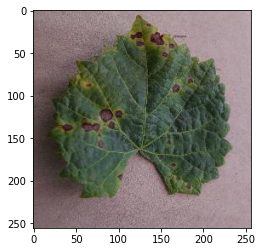

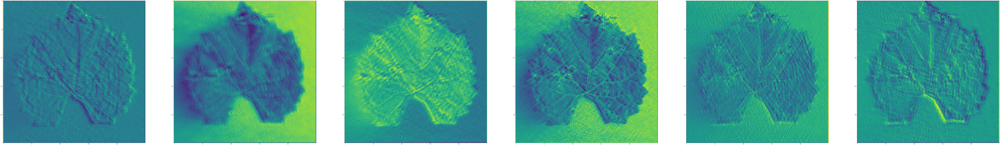

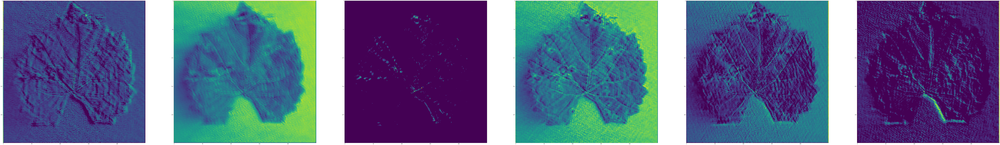

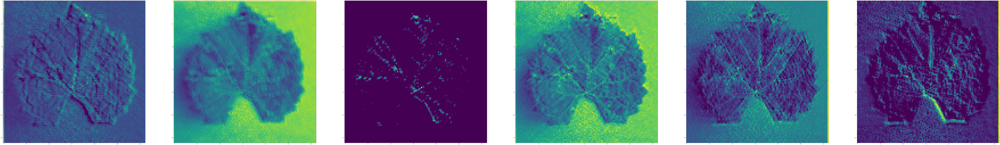

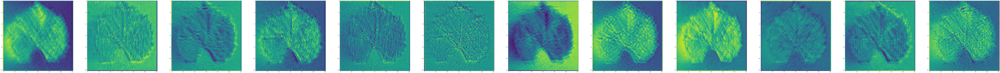

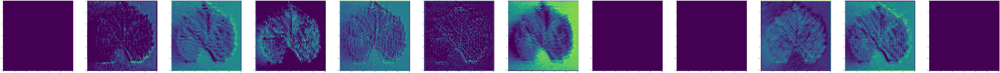

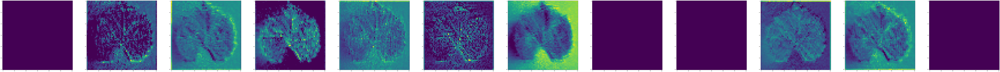

In [41]:
# Here we look at a single image. Our intent is to see how does an image transform through the convolution model that 
# we are proposing
img_one_feature = feature[:1]
img_one_label = label[:1]
img_one_feature.shape, img_one_label.shape

plt.imshow(img_one_feature[0].permute(1,2,0))

# We define a convolution that converts the RGB channel into 6 features/filters/channels using a kernel size of 3 
# a stride of 1 and padding of 1. On this we would apply pooling of 2*2
cnv1 = nn.Conv2d(3, 6, kernel_size=9, padding=1, stride=1)
#print(cnv1.weight, cnv1.bias)
layer1 = cnv1(img_one_feature)
fig, axes = plt.subplots(figsize=(200,100), ncols=6)
for i in range(6):
    x = torch.tensor(layer1[0,i:i+1,:], requires_grad=False)
    ax = axes[i]
    ax.imshow(x.permute(1, 2, 0))

layer1 = F.relu(layer1)
fig, axes = plt.subplots(figsize=(200,100), ncols=6)
for i in range(6):
    x = torch.tensor(layer1[0,i:i+1,:], requires_grad=False)
    ax = axes[i]
    ax.imshow(x.permute(1, 2, 0))

pool = nn.MaxPool2d(2, 2)    
layer1 = pool(layer1)
fig, axes = plt.subplots(figsize=(200,100), ncols=6)
for i in range(6):
    x = torch.tensor(layer1[0,i:i+1,:], requires_grad=False)
    ax = axes[i]
    ax.imshow(x.permute(1, 2, 0))
print()


# We define a convolution that converts the RGB channel into 12 features/filters/channels using a kernel size of 3 
# a stride of 1 and padding of 1. On this we would apply pooling of 2*2
cnv2 = nn.Conv2d(6, 12, kernel_size=6, padding=1, stride=1)
#print(cnv2.weight, cnv1.bias)
layer2 = cnv2(layer1)
fig, axes = plt.subplots(figsize=(200,100), ncols=12)
for i in range(12):
    x = torch.tensor(layer2[0,i:i+1,:], requires_grad=False)
    ax = axes[i]
    ax.imshow(x.permute(1, 2, 0))

layer2 = F.relu(layer2)
fig, axes = plt.subplots(figsize=(200,100), ncols=12)
for i in range(12):
    x = torch.tensor(layer2[0,i:i+1,:], requires_grad=False)
    ax = axes[i]
    ax.imshow(x.permute(1, 2, 0))

pool = nn.MaxPool2d(2, 2)    
layer2 = pool(layer2)
fig, axes = plt.subplots(figsize=(200,100), ncols=12)
for i in range(12):
    x = torch.tensor(layer2[0,i:i+1,:], requires_grad=False)
    ax = axes[i]
    ax.imshow(x.permute(1, 2, 0))
print()


# We define a convolution that converts the RGB channel into 12 features/filters/channels using a kernel size of 3 
# a stride of 1 and padding of 1. On this we would apply pooling of 2*2
cnv3 = nn.Conv2d(12, 36, kernel_size=3, padding=1, stride=1)
#print(cnv3.weight, cnv1.bias)
layer3 = cnv3(layer2)
fig, axes = plt.subplots(figsize=(200,100), ncols=12, nrows=3)
for i in range(3):
    for j in range(12):
        x = torch.tensor(layer3[0,(12*i) + j: (12*i) + j + 1,:], requires_grad=False)
        ax = axes[i][j]
        ax.imshow(x.permute(1, 2, 0))

layer3 = F.relu(layer3)
fig, axes = plt.subplots(figsize=(200,100), ncols=12, nrows=3)
for i in range(3):
    for j in range(12):
        x = torch.tensor(layer3[0,(12*i) + j: (12*i) + j + 1,:], requires_grad=False)
        ax = axes[i][j]
        ax.imshow(x.permute(1, 2, 0))

pool = nn.MaxPool2d(2, 2)    
layer3 = pool(layer3)
fig, axes = plt.subplots(figsize=(200,100), ncols=12, nrows=3)
for i in range(3):
    for j in range(12):
        x = torch.tensor(layer3[0,(12*i) + j: (12*i) + j + 1,:], requires_grad=False)
        ax = axes[i][j]
        ax.imshow(x.permute(1, 2, 0))
print()

In [2]:
# Now create a a model that can be trained for disease detection
class Net(nn.Module):
    def __init__(self):
        super(Net, self).__init__()
        self.conv1 = nn.Conv2d(3, 6, 9)
        self.pool = nn.MaxPool2d(2, 2)
        self.conv2 = nn.Conv2d(6, 12, 6)
        self.conv3 = nn.Conv2d(12, 18, 3)
        self.fc1 = nn.Linear(18 * 28 * 28, 4096)
        self.fc2 = nn.Linear(4096, 1024)
        self.fc3 = nn.Linear(1024, 512)
        self.fc4 = nn.Linear(512, 38)

    def forward(self, x):
        x = self.pool(F.relu(self.conv1(x)))
        x = self.pool(F.relu(self.conv2(x)))
        x = self.pool(F.relu(self.conv3(x)))
        x = torch.flatten(x, 1)
        x = F.relu(self.fc1(x))
        x = F.relu(self.fc2(x))
        x = F.relu(self.fc3(x))
        x = self.fc4(x)
        return x

In [150]:
net = Net()
criterion = nn.CrossEntropyLoss()
optimizer = optim.SGD(net.parameters(), lr=0.001, momentum=0.9)

In [ ]:
# Print model's state_dict
print("Model's state_dict:")
for param_tensor in net.state_dict():
    print(param_tensor, "\t", net.state_dict()[param_tensor].size())

In [151]:
# Print optimizer's state_dict
print("Optimizer's state_dict:")
for var_name in optimizer.state_dict():
    print(var_name, "\t", optimizer.state_dict()[var_name])

Optimizer's state_dict:
state 	 {}
param_groups 	 [{'lr': 0.001, 'momentum': 0.9, 'dampening': 0, 'weight_decay': 0, 'nesterov': False, 'params': [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13]}]


In [ ]:
device = torch.device('cuda:0' if torch.cuda.is_available() else 'cpu')
print(device)

In [ ]:
net.to(device)

In [156]:
for epoch in range(10):  # loop over the dataset multiple times
    running_loss = 0.0
    total = 0
    correct = 0
    net.train()
    for i, data in enumerate(crop_loader, 0):
        inputs, labels = data[0].to(device), data[1].to(device)
        optimizer.zero_grad()
        
        outputs = net(inputs)
        loss = criterion(outputs, labels)
        loss.backward()
        optimizer.step()

        # print statistics
        running_loss += loss.item()
        
        _, predicted = outputs.max(1)
        total += labels.size(0)
        correct += predicted.eq(labels).sum().item()
        
        if i % 100 == 99:
            print(f'Processed {i} batch of 128 images')
            
        if i % 500 == 499:    # print every 2000 mini-batches
            accu=100.*correct/total
            
            print(f'[{epoch + 1}, {i + 1:5d}] loss: {running_loss / 500:.3f} accuracy:{accu:.3f}')
            running_loss = 0.0
print('Finished Training')

Processed batch 99 with 128 images
Processed batch 199 with 128 images
Processed batch 299 with 128 images
Processed batch 399 with 128 images
Processed batch 499 with 128 images
[1,   500] loss: 1.895 accuracy:43.502
Processed batch 99 with 128 images
Processed batch 199 with 128 images
Processed batch 299 with 128 images
Processed batch 399 with 128 images
Processed batch 499 with 128 images
[2,   500] loss: 1.511 accuracy:53.650
Processed batch 99 with 128 images
Processed batch 199 with 128 images
Processed batch 299 with 128 images
Processed batch 399 with 128 images
Processed batch 499 with 128 images
[3,   500] loss: 1.191 accuracy:62.783
Processed batch 99 with 128 images
Processed batch 199 with 128 images
Processed batch 299 with 128 images
Processed batch 399 with 128 images
Processed batch 499 with 128 images
[4,   500] loss: 0.970 accuracy:69.152
Processed batch 99 with 128 images
Processed batch 199 with 128 images
Processed batch 299 with 128 images
Processed batch 399 w

In [157]:
torch.save(net.state_dict(), 'crop_disease_model_local.pth')

## Inference

In [10]:
net = Net()
net.load_state_dict(torch.load('./crop_disease_model_kaggle.pth', map_location='cpu'))
net.eval()

Net(
  (conv1): Conv2d(3, 6, kernel_size=(9, 9), stride=(1, 1))
  (pool): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
  (conv2): Conv2d(6, 12, kernel_size=(6, 6), stride=(1, 1))
  (conv3): Conv2d(12, 18, kernel_size=(3, 3), stride=(1, 1))
  (fc1): Linear(in_features=14112, out_features=4096, bias=True)
  (fc2): Linear(in_features=4096, out_features=1024, bias=True)
  (fc3): Linear(in_features=1024, out_features=512, bias=True)
  (fc4): Linear(in_features=512, out_features=38, bias=True)
)

In [123]:
net = torch.load('./crop_disease_model_vgg.pth', map_location=torch.device('cpu'))
net.eval()

VGG(
  (features): Sequential(
    (0): Conv2d(3, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (1): ReLU(inplace=True)
    (2): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (3): ReLU(inplace=True)
    (4): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
    (5): Conv2d(64, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (6): ReLU(inplace=True)
    (7): Conv2d(128, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (8): ReLU(inplace=True)
    (9): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
    (10): Conv2d(128, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (11): ReLU(inplace=True)
    (12): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (13): ReLU(inplace=True)
    (14): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (15): ReLU(inplace=True)
    (16): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1

In [124]:
# Here we create our final transformation that would be used before we send the data for training the model
transform = torchvision.transforms.Compose([transforms.ToTensor(), \
                                            transforms.Normalize((0.4743617, 0.49847862, 0.4265874 ), \
                                                                 (0.21134755, 0.19044809, 0.22679578))
                                           ]
                                          )
test_dataset = torchvision.datasets.ImageFolder('./dataset/valid', transform=transform)
test_dataset.class_to_idx

{'Apple___Apple_scab': 0,
 'Apple___Black_rot': 1,
 'Apple___Cedar_apple_rust': 2,
 'Apple___healthy': 3,
 'Blueberry___healthy': 4,
 'Cherry_(including_sour)___Powdery_mildew': 5,
 'Cherry_(including_sour)___healthy': 6,
 'Corn_(maize)___Cercospora_leaf_spot Gray_leaf_spot': 7,
 'Corn_(maize)___Common_rust_': 8,
 'Corn_(maize)___Northern_Leaf_Blight': 9,
 'Corn_(maize)___healthy': 10,
 'Grape___Black_rot': 11,
 'Grape___Esca_(Black_Measles)': 12,
 'Grape___Leaf_blight_(Isariopsis_Leaf_Spot)': 13,
 'Grape___healthy': 14,
 'Orange___Haunglongbing_(Citrus_greening)': 15,
 'Peach___Bacterial_spot': 16,
 'Peach___healthy': 17,
 'Pepper,_bell___Bacterial_spot': 18,
 'Pepper,_bell___healthy': 19,
 'Potato___Early_blight': 20,
 'Potato___Late_blight': 21,
 'Potato___healthy': 22,
 'Raspberry___healthy': 23,
 'Soybean___healthy': 24,
 'Squash___Powdery_mildew': 25,
 'Strawberry___Leaf_scorch': 26,
 'Strawberry___healthy': 27,
 'Tomato___Bacterial_spot': 28,
 'Tomato___Early_blight': 29,
 'Toma

In [125]:
# Now we can create a loader that will help us load images in batches for training purpose 
test_loader = DataLoader(test_dataset, batch_size=128, shuffle=True)

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


torch.Size([4, 3, 256, 256])
torch.Size([3, 1034, 260])
GroundTruth:     11    26     4     8


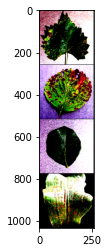

In [126]:
dataiter = iter(test_loader)
images, labels = dataiter.next()
print(images[0:4,:,:].shape)
grid_image = torchvision.utils.make_grid(images[0:4,:,:], nrow=1)
print(grid_image.shape)
plt.imshow(grid_image.permute(1, 2, 0))
print('GroundTruth: ', ' '.join(f'{labels[j]:5d}' for j in range(4)))

In [ ]:
correct = 0
total = 0
# since we're not training, we don't need to calculate the gradients for our outputs
with torch.no_grad():
    for data in test_loader:
        images, labels = data
        # calculate outputs by running images through the network
        outputs = net(images)
        # the class with the highest energy is what we choose as prediction
        _, predicted = torch.max(outputs.data, 1)
        total += labels.size(0)
        correct += (predicted == labels).sum().item()

print(f'Accuracy of the network on the test images: {100 * correct // total} %')

In [ ]:
# prepare to count predictions for each class
correct_pred = {value:0 for key, value in test_dataset.class_to_idx.items()}
total_pred = {value:0 for key, value in test_dataset.class_to_idx.items()}

# again no gradients needed
with torch.no_grad():
    for data in test_loader:
        images, labels = data
        outputs = net(images)
        _, predictions = torch.max(outputs, 1)
        # collect the correct predictions for each class
        for label, prediction in zip(labels, predictions):
            if label == prediction:
                correct_pred[int(label)] += 1
            total_pred[int(label)] += 1


# print accuracy for each class
for key, correct_count in correct_pred.items():
    accuracy = 100 * float(correct_count) / total_pred[key]
    print(f'Accuracy for class: {key:5d} is {accuracy:.1f} %')

In [22]:
net.conv3.weight.shape

torch.Size([18, 12, 3, 3])

In [23]:
for param in net.parameters():
    print(param.shape)

torch.Size([6, 3, 9, 9])
torch.Size([6])
torch.Size([12, 6, 6, 6])
torch.Size([12])
torch.Size([18, 12, 3, 3])
torch.Size([18])
torch.Size([4096, 14112])
torch.Size([4096])
torch.Size([1024, 4096])
torch.Size([1024])
torch.Size([512, 1024])
torch.Size([512])
torch.Size([38, 512])
torch.Size([38])


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


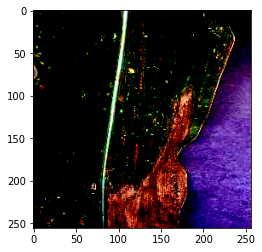

In [87]:
plt.imshow(images[9:10,:,:][0].permute(1,2,0))

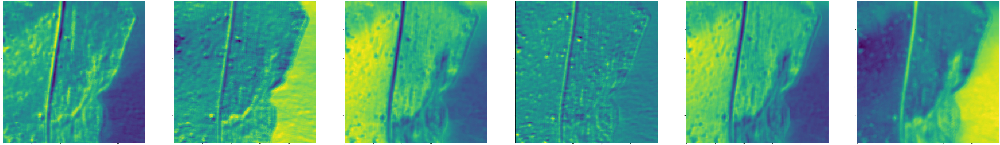

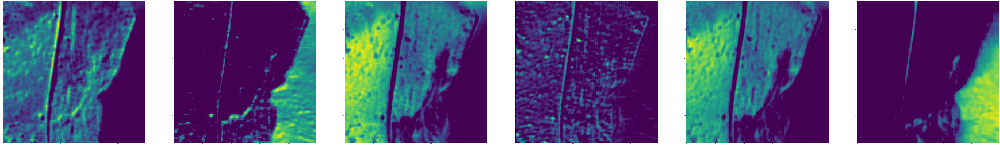

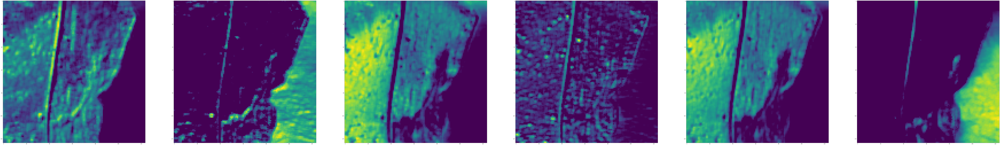

In [88]:
temp = net.conv1(images[9:10,:,:])
temp = torch.tensor(temp, requires_grad=False)
fig, axes = plt.subplots(figsize=(200,100), ncols=6)
for i in range(6):
    x = temp[0,i:i+1,:]
    ax = axes[i]
    ax.imshow(x.permute(1, 2, 0))
    
temp = F.relu(temp)
fig, axes = plt.subplots(figsize=(200,100), ncols=6)
for i in range(6):
    x = temp[0,i:i+1,:]
    ax = axes[i]
    ax.imshow(x.permute(1, 2, 0))

pool = nn.MaxPool2d(2, 2)    
temp = pool(temp)
fig, axes = plt.subplots(figsize=(200,100), ncols=6)
for i in range(6):
    x = temp[0,i:i+1,:]
    ax = axes[i]
    ax.imshow(x.permute(1, 2, 0))
print()

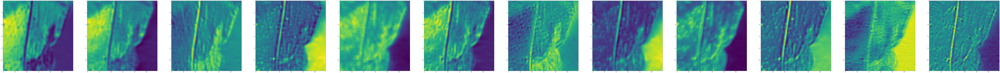

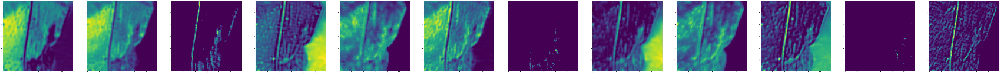

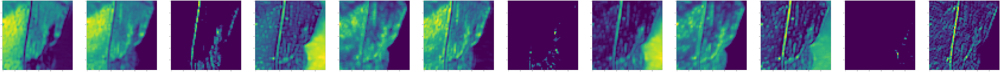

In [89]:
# We define a convolution that converts the RGB channel into 12 features/filters/channels using a kernel size of 3 
# a stride of 1 and padding of 1. On this we would apply pooling of 2*2
temp2 = net.conv2(temp)
temp2 = torch.tensor(temp2, requires_grad=False)
fig, axes = plt.subplots(figsize=(200,100), ncols=12)
for i in range(12):
    x = temp2[0,i:i+1,:]
    ax = axes[i]
    ax.imshow(x.permute(1, 2, 0))

temp2 = F.relu(temp2)
fig, axes = plt.subplots(figsize=(200,100), ncols=12)
for i in range(12):
    x = temp2[0,i:i+1,:]
    ax = axes[i]
    ax.imshow(x.permute(1, 2, 0))

pool = nn.MaxPool2d(2, 2)    
temp2 = pool(temp2)
fig, axes = plt.subplots(figsize=(200,100), ncols=12)
for i in range(12):
    x = temp2[0,i:i+1,:]
    ax = axes[i]
    ax.imshow(x.permute(1, 2, 0))
print()

In [111]:
# We define a convolution that converts the RGB channel into 12 features/filters/channels using a kernel size of 3 
# a stride of 1 and padding of 1. On this we would apply pooling of 2*2
temp3 = net.conv3(temp2)
temp3 = torch.tensor(temp3, requires_grad=False)
fig, axes = plt.subplots(figsize=(200,100), ncols=6, nrows=3)
for i in range(3):
    for j in range(6):
        x = temp3[0,(6*i) + j: (6*i) + j + 1,:]
        ax = axes[i][j]
        ax.imshow(x.permute(1, 2, 0))

temp3 = F.relu(temp3)
fig, axes = plt.subplots(figsize=(200,100), ncols=6, nrows=3)
for i in range(3):
    for j in range(6):
        x = temp3[0,(6*i) + j: (6*i) + j + 1,:]
        ax = axes[i][j]
        ax.imshow(x.permute(1, 2, 0))

pool = nn.MaxPool2d(2, 2)    
temp3 = pool(temp3)
fig, axes = plt.subplots(figsize=(200,100), ncols=6, nrows=3)
for i in range(3):
    for j in range(6):
        x = temp3[0,(6*i) + j: (6*i) + j + 1,:]
        ax = axes[i][j]
        ax.imshow(x.permute(1, 2, 0))
print()

## VGG Model

In [ ]:
vgg_model = models.vgg16(pretrained=True)
vgg_model

In [ ]:
vgg_model.classifier[6].out_features = 38
vgg_model

In [ ]:
# freeze feature extractor weights
for param in vgg_model.features.parameters():
    param.requires_grad = False

In [ ]:
# num_features = vgg_model.classifier[6].in_features
# features = list(vgg_model.classifier.children())[:-1] # Remove last layer
# features.extend([nn.Linear(num_features, 38)])
# vgg_model.classifier = nn.Sequential(*features)
# vgg_model

In [ ]:
criterion = nn.CrossEntropyLoss()
optimizer = torch.optim.SGD(vgg_model.parameters(), lr=0.001, momentum=0.9)

In [ ]:
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
print(device)
vgg_model = vgg_model.to(device)

In [ ]:
LOG_AFTER_BATCHES = 100

total_train_loss = 0.0
total_val_loss = 0.0

for epoch in range(5):  # loop over the dataset multiple times
    epoch_train_loss = 0.0
    vgg_model.train()
    for i, data in enumerate(train_dataloader):
        # get the inputs; data is a list of [inputs, labels]
        inputs, labels = data
        inputs, labels = inputs.to(device), labels.to(device)
        # zero the parameter gradients
        optimizer.zero_grad()

        # forward + backward + optimize
        outputs = vgg_model(inputs)
        loss = criterion(outputs, labels)
        loss.backward()
        optimizer.step()

        # print statistics
        epoch_train_loss += loss.item()
        if i % LOG_AFTER_BATCHES == (LOG_AFTER_BATCHES - 1):
            print(f'[{epoch + 1}, {i + 1:5d}] train loss: {epoch_train_loss / (BATCH_SIZE * i):.5f}')
    
    total_train_loss += epoch_train_loss
    # An epoch done. Calculate val loss now
    epoch_val_loss = 0.0
    vgg_model.eval()
    for i, data in enumerate(val_dataloader):
        # get the inputs; data is a list of [inputs, labels]
        inputs, labels = data
        inputs, labels = inputs.to(device), labels.to(device)

        # forward + backward + optimize
        outputs = vgg_model(inputs)
        loss = criterion(outputs, labels)
        # print statistics
        epoch_val_loss += loss.item()

    total_val_loss += epoch_val_loss

    # Print train and val loss at the end of an epoch
    print(f'[{epoch + 1}, {i + 1:5d}] total train loss: {total_train_loss / (BATCH_SIZE * (epoch + 1) * len(train_dataloader)):.5f}')
    print(f'[{epoch + 1}, {i + 1:5d}] total val loss: {total_val_loss / (BATCH_SIZE * (epoch + 1) * len(val_dataloader)):.5f}')
print('Finished Training')

In [ ]:
correct = 0
total = 0
# since we're not training, we don't need to calculate the gradients for our outputs
with torch.no_grad():
    for data in val_dataloader:
        inputs, labels = data
        inputs, labels = inputs.to(device), labels.to(device)
        # calculate outputs by running images through the network
        outputs = vgg_model(inputs)
        # the class with the highest energy is what we choose as prediction
        _, predicted = torch.max(outputs.data, 1)
        total += labels.size(0)
        correct += (predicted == labels).sum().item()

print(f'Accuracy of the network on the test images: {100 * correct // total} %')